In [1]:
import pandas as pd
import xml.etree.ElementTree as ET
import glob
import os


_dir=r'C:\Users\mehdi\Desktop\est'

os.chdir(_dir)

elements = ['Image','height','width','depth','coin_1','coin_2','coin_3','coin_4']

df=pd.DataFrame(columns=elements)

# Initialize empty lists to store coin information
coin_names = []
coin_values = {}


# Iterate over XML files in the directory
for xml_file in glob.glob('*.xml'):
    if xml_file.endswith('.xml'):
        # Parse the XML file
        tree = ET.parse(os.path.join(_dir, xml_file))
        root = tree.getroot()

        # Extract the annotation file name
        file_name = root.find('filename').text
        
        # Extract size information
        width = int(root.find('size/width').text)
        height = int(root.find('size/height').text)
        depth = int(root.find('size/depth').text)
        
        
        # Iterate over the 'object' elements
        for obj in root.iter('object'):
            # Extract the coin name
            coin_name = obj.find('name').text
            
            # Extract the coin value (xmin, ymin, xmax, ymax)
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)

            # Store the coin value in the dictionary
            coin_values[coin_name] = (xmin, xmax, ymin, ymax)
    
        tmp_df=pd.DataFrame([coin_values], columns=['Image','height','width','depth'] + list(coin_values.keys()))
        # Set the 'filename' column value
        tmp_df['Image'] = file_name
        tmp_df['height']=height
        tmp_df['width']=width
        tmp_df['depth']=depth
        # Append the data to the DataFrame
        df = pd.concat([df,tmp_df], ignore_index=True)
        


# Print the DataFrame
print(df.describe)

<bound method NDFrame.describe of      Image height width depth                coin_1                coin_2  \
0    0.jpg    448   448     3      (77, 77, 73, 73)    (17, 17, 245, 245)   
1    1.jpg    448   448     3    (89, 89, 167, 167)      (93, 93, 93, 93)   
2   10.jpg    448   448     3    (78, 78, 341, 341)    (20, 20, 186, 186)   
3   11.jpg    448   448     3    (69, 69, 340, 340)    (31, 31, 213, 213)   
4   12.jpg    448   448     3    (72, 72, 338, 338)    (32, 32, 209, 209)   
5   13.jpg    448   448     3    (74, 74, 277, 277)    (26, 26, 163, 163)   
6   14.jpg    448   448     3  (100, 100, 284, 284)    (42, 42, 169, 169)   
7   15.jpg    448   448     3    (87, 87, 256, 256)    (35, 35, 158, 158)   
8   16.jpg    448   448     3  (101, 101, 249, 249)    (39, 39, 147, 147)   
9   17.jpg    448   448     3    (66, 66, 262, 262)    (19, 19, 171, 171)   
10  18.jpg    448   448     3    (81, 81, 287, 287)    (28, 28, 196, 196)   
11  19.jpg    448   448     3    (72, 72, 

In [2]:
print([df[df[f'coin_{i}'].apply(lambda x: x[2]) != df[f'coin_{i}'].apply(lambda x: x[3])] for i in range(1,5)])
print(df[df.height<448])

[Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: []]
Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: []


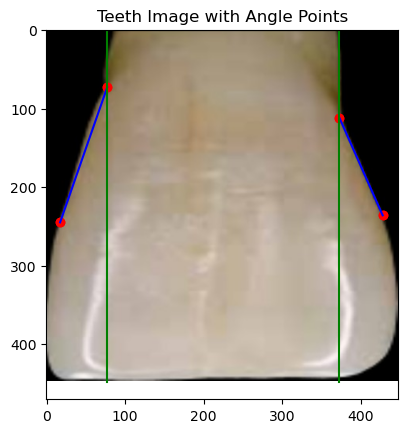

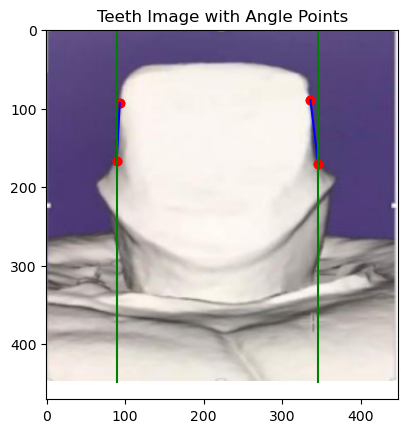

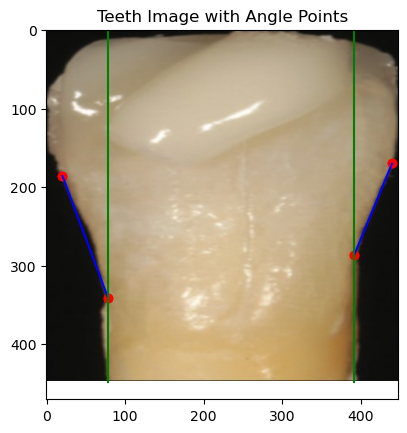

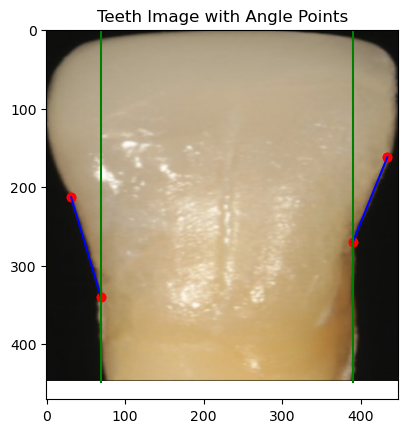

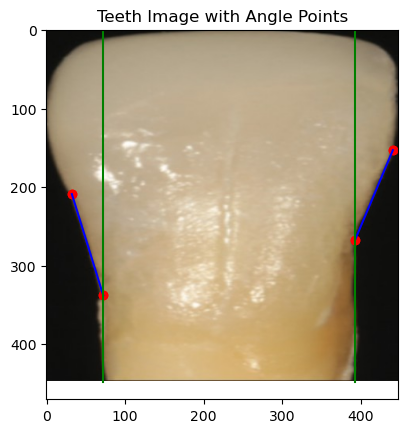

...

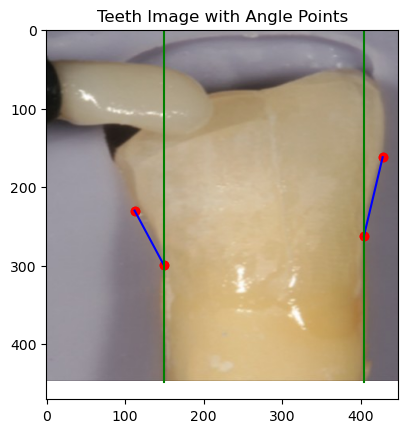

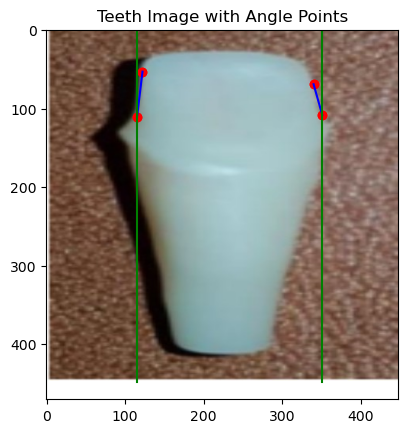

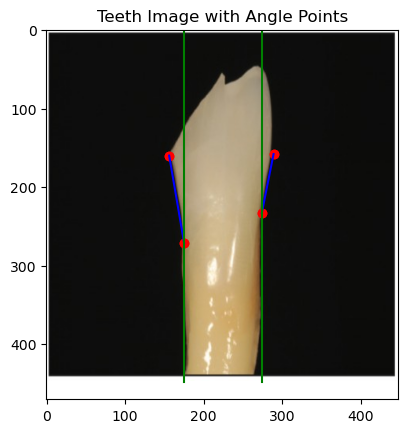

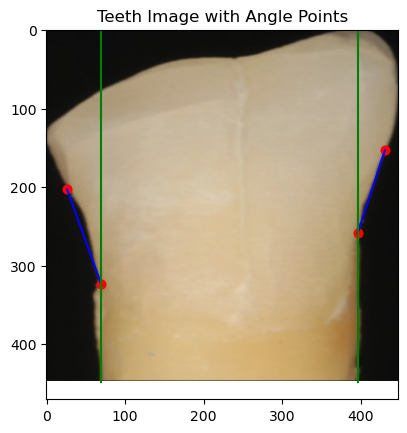

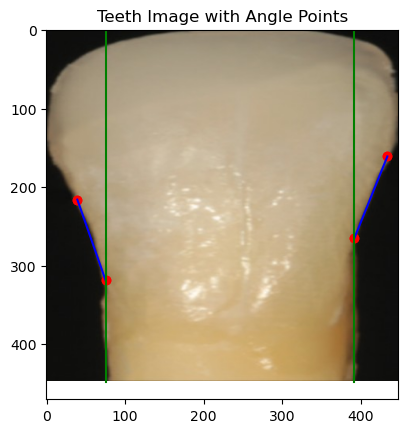

In [3]:
import matplotlib.pyplot as plt
import cv2

images=df.Image

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    angle = [df.loc[i,f'coin_{x}'] for x in range(1,5)]

    # Plot image with angle points
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    for p in angle:
        plt.scatter([p[0],p[1]], [p[2],p[3]], color='red')  # Plot the x and y coordinates separately
        # Draw a line between the two points
        plt.plot()
    # Draw lines between the angle points
    for j in [0,2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        x_c00rds = [angle[j][0],angle[j][0]]
        y_c00rds = [448,0]
        plt.plot(x_coords, y_coords, color='blue')
        plt.plot(x_c00rds, y_c00rds, color='green')
    plt.title('Teeth Image with Angle Points')
    plt.show()

In [13]:
import cv2
import numpy as np

images = df.Image
output_folder=_dir+'/masks'

# Set the output folder to save the resulting images
os.makedirs(output_folder, exist_ok=True)

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    mask = np.zeros_like(image)
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points and lines
    #for p in angle:
        #cv2.circle(mask, (p[0], p[2]), 3, (0, 0, 255), -1)  # Draw red circles at angle points

    # Draw lines between the angle points
    for j in [0, 2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        cv2.line(mask, (x_coords[0], y_coords[0]), (x_coords[1], y_coords[1]), (255, 255, 255), 2)  # Draw blue lines

    # Prepare mask for augmentation
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)  # Convert mask to grayscale
    mask = np.expand_dims(mask, axis=-1)  # Add channel dimension
    
    # Save the resulting image
    output_path = os.path.join(output_folder, f'mask_{images[i][:-4]}.jpg')
    cv2.imwrite(output_path, mask)
    

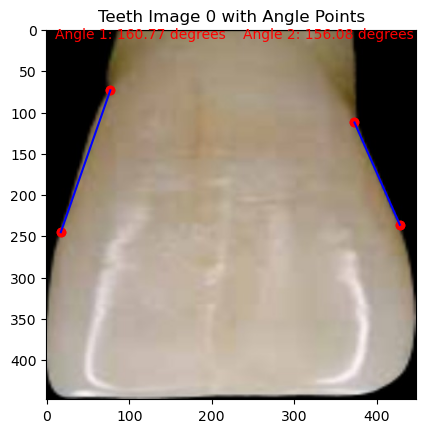

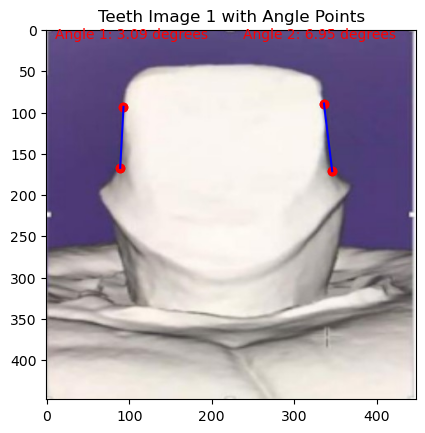

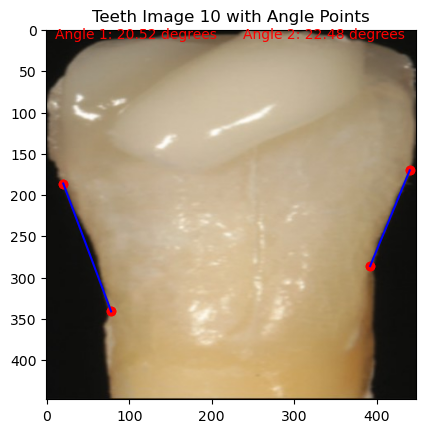

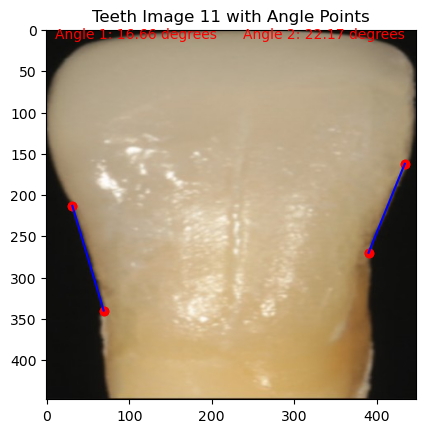

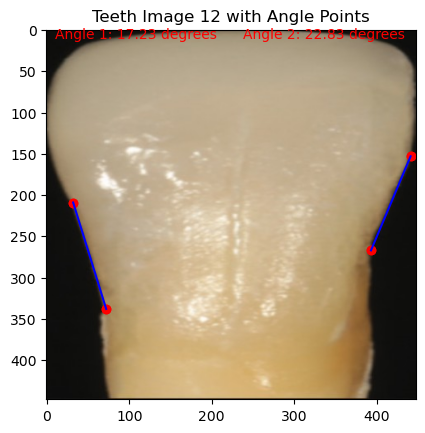

...

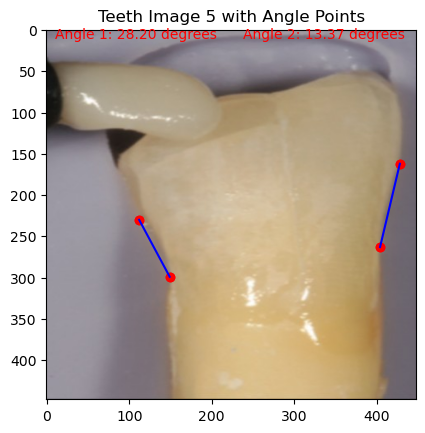

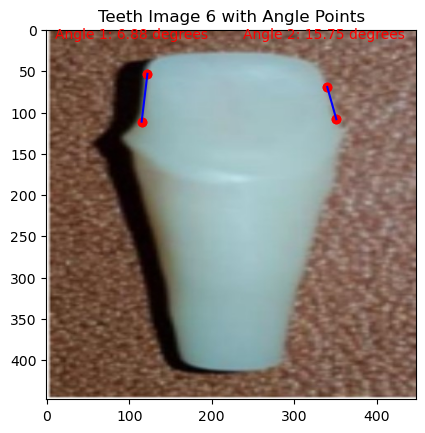

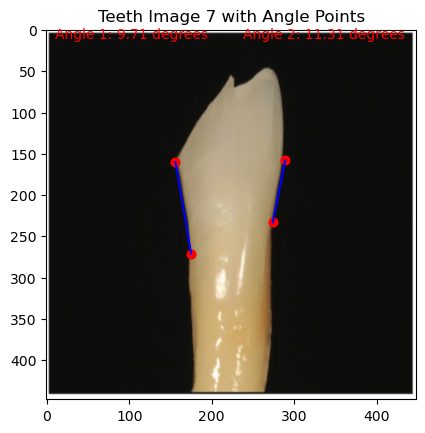

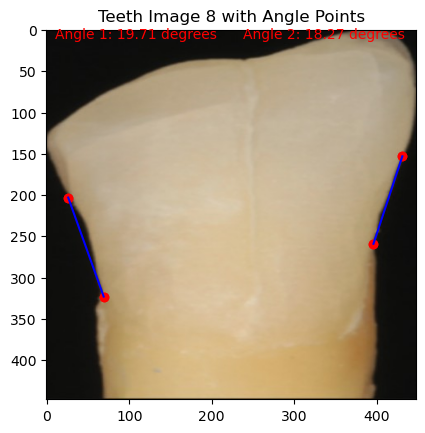

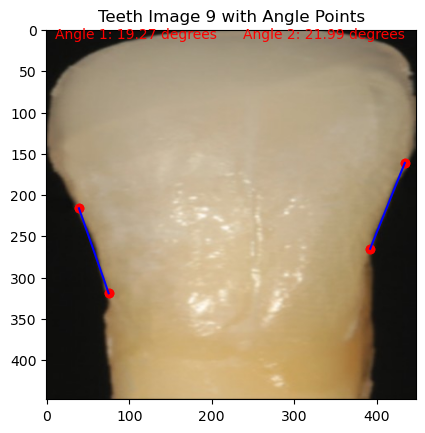

In [4]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

images = df.Image

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    # Plot scatter points
    for p in angle:
        plt.scatter([p[0], p[1]], [p[2], p[3]], color='red')

    angs=[]
        
    # Draw lines between the angle points
    for j in [0,2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        plt.plot(x_coords, y_coords, color='blue')

        # Calculate angle between two lines
        # Define the starting points of the two lines
        line1_start = np.array([angle[j][0], angle[j][2]])
        line2_start = np.array([angle[j+1][0], 448])

        # Define the ending points of the two lines
        line1_end = np.array([angle[j+1][0], angle[j+1][2]])
        line2_end = np.array([angle[j+1][0], 0])
    
        # Calculate the direction vectors of the two lines
        line1_vector = line1_end - line1_start
        line2_vector = line2_end - line2_start

        dot_product = np.dot(line1_vector, line2_vector)
        magnitude_product = np.linalg.norm(line1_vector) * np.linalg.norm(line2_vector)
        angle_rad = np.arccos(dot_product / magnitude_product)
        angle_deg = np.degrees(angle_rad)
        angs.append(angle_deg)

    plt.title(f'Teeth Image {images[i][:-4]} with Angle Points')
    plt.text(10, 10, f'Angle 1: {angs[0]:.2f} degrees', color='red') if angs[0] < 180 else  plt.text(10, 10, f'Angle: {angs[0]-360:.2f} degrees', color='red')
    plt.text(238, 10, f'Angle 2: {angs[1]:.2f} degrees', color='red') if angs[1] < 180 else  plt.text(10, 10, f'Angle: {angs[1]-360:.2f} degrees', color='red')
    #df.loc[i, 'Angle 1'] = angs[0] if angs[0] < 180 else angs[0]-180
    #df.loc[i, 'Angle 2'] = angs[1] if angs[1] < 180 else angs[1]-180
    plt.show()

In [5]:
import cv2
import matplotlib.pyplot as plt

# Load images and masks
images = []
masks = []


for im in df.Image:
    mask_path = f'masks/mask_{im[:-4]}.jpg'

    image = cv2.imread(im)
    mask = cv2.imread(mask_path)

    images.append(image)
    masks.append(mask)

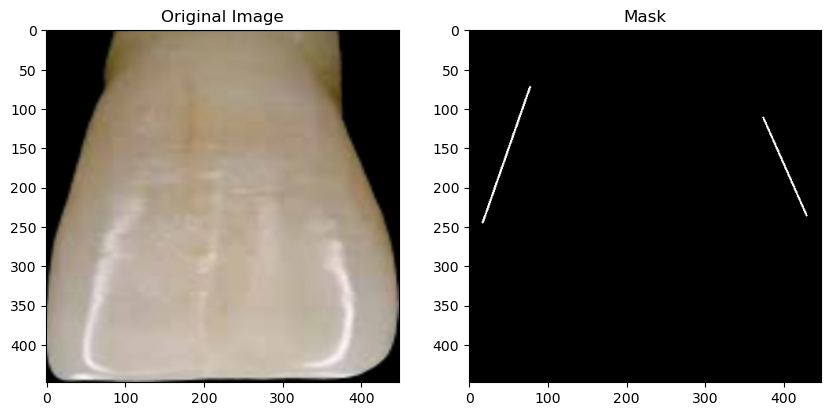

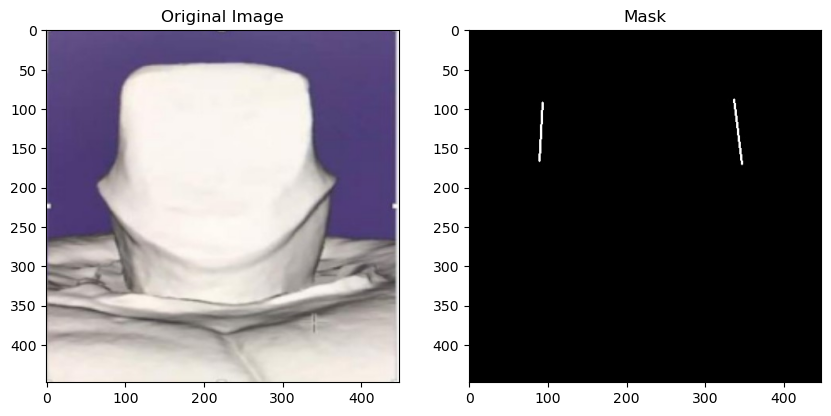

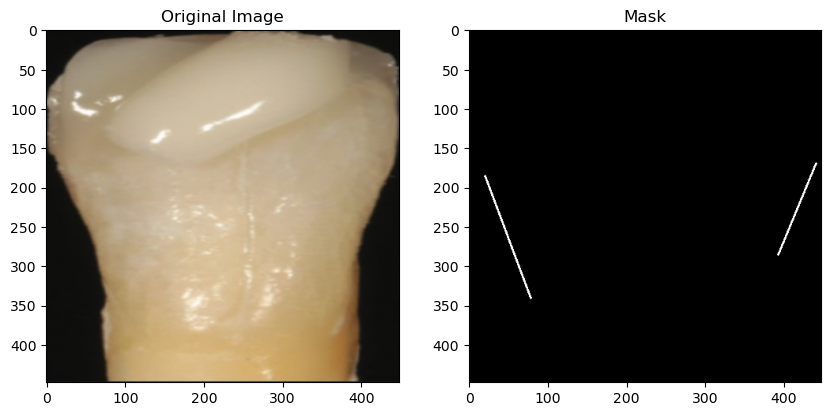

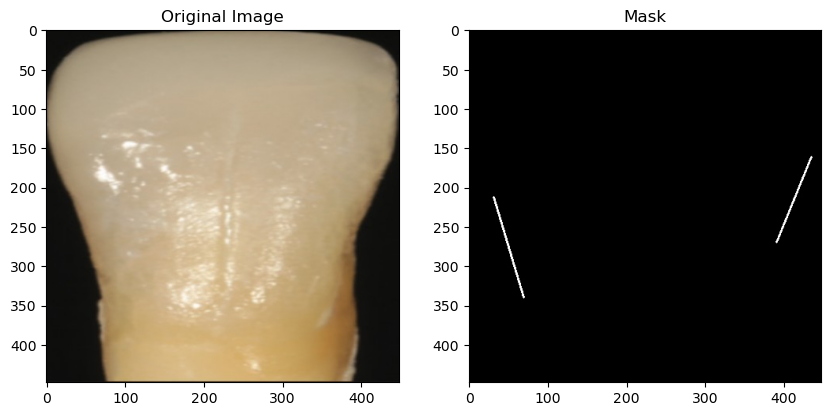

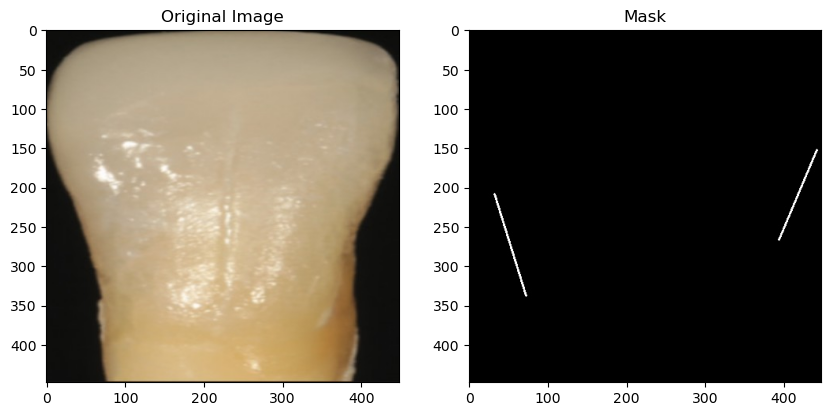

...

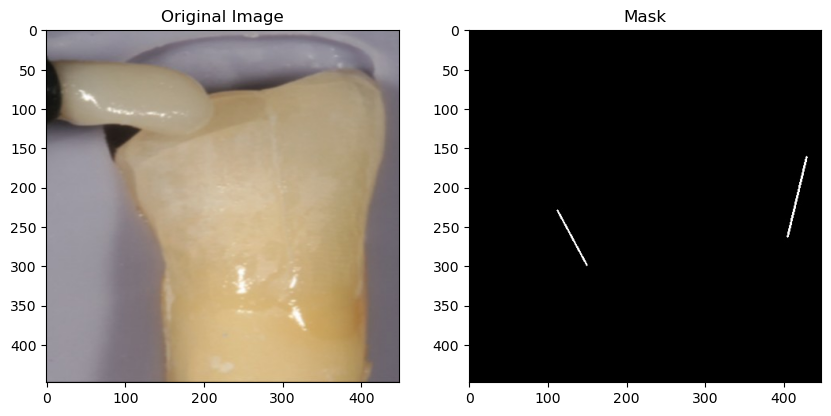

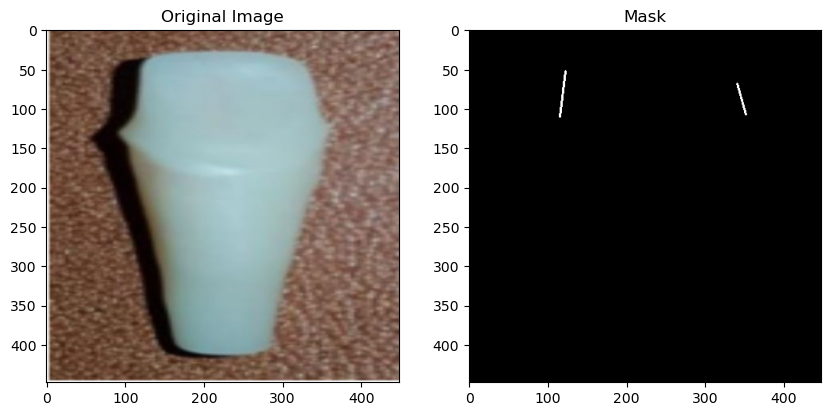

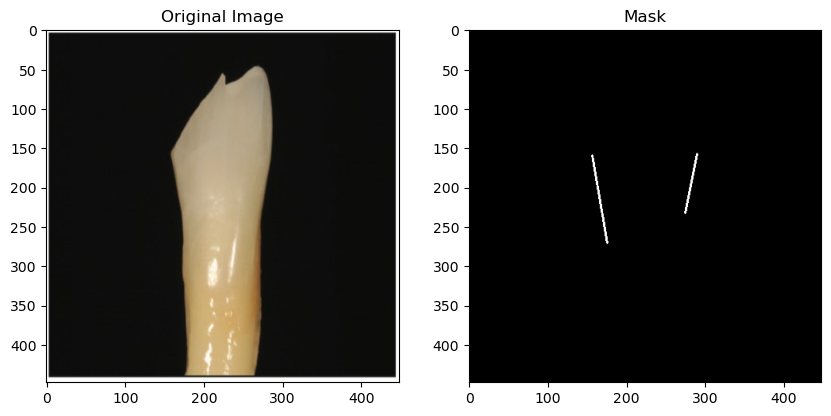

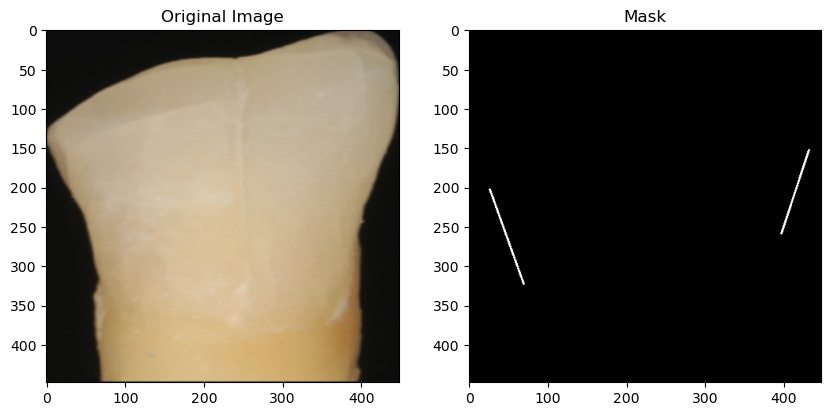

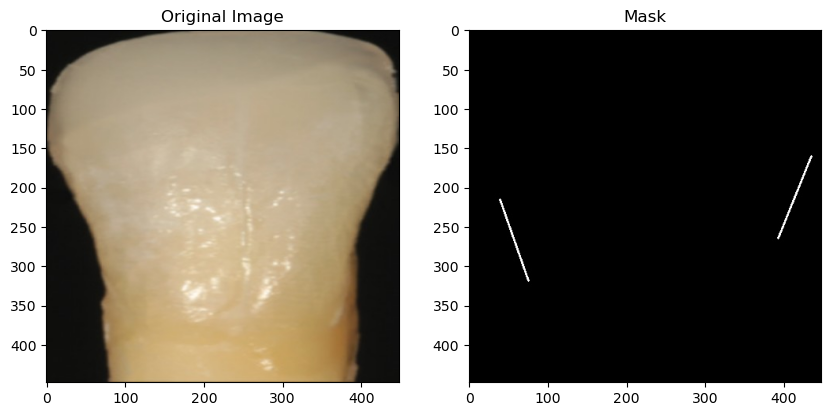

In [6]:
# Display images and masks side by side
for image, mask in zip(images, masks):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Display the original image
    axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image')

    # Display the mask
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title('Mask')

    plt.show()

In [7]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Normalization function
def normalize_image(image):
    return image / 255.0

# Updated image data generator with more augmentations
data_generator = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=True,
    shear_range=0.1,
    zoom_range=0.1,
    brightness_range=[0.8, 1.2],
    fill_mode='constant',
    cval=0,
    preprocessing_function=normalize_image  # Normalize images
)

# Use the same data generator for both images and masks to maintain correspondence

# Generate augmented images and masks
augmented_images = []
augmented_masks = []

for image, mask in zip(images, masks):
    image_batch = np.expand_dims(image, axis=0)
    mask_batch = np.expand_dims(mask, axis=0)

    # Apply data augmentation to images
    augmented_image_batch = data_generator.flow(image_batch, batch_size=1, shuffle=False)

    # Apply data augmentation to masks (use the same seed for consistency)
    augmented_mask_batch = data_generator.flow(mask_batch, batch_size=1, shuffle=False)

    augmented_image = next(augmented_image_batch)[0]
    augmented_mask = next(augmented_mask_batch)[0]

    augmented_images.append(augmented_image)
    augmented_masks.append(augmented_mask)

augmented_images = np.array(augmented_images)
augmented_masks = np.array(augmented_masks)

# Check the shapes of augmented images and masks
print(f'Augmented Images Size : {augmented_images.size}, Shape : {augmented_images.shape}')
print(f'Augmented Masks Size : {augmented_masks.size}, Shape : {augmented_masks.shape}')


Augmented Images Size : 28901376, Shape : (48, 448, 448, 3)
Augmented Masks Size : 28901376, Shape : (48, 448, 448, 3)


In [24]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, BatchNormalization, Activation

def build_unet(input_shape):
    inputs = Input(input_shape)

    # Encoder
    conv1 = Conv2D(64, 3, padding='same')(inputs)
    conv1 = BatchNormalization()(conv1)
    conv1 = Activation('relu')(conv1)
    conv1 = Conv2D(64, 3, padding='same')(conv1)
    conv1 = BatchNormalization()(conv1)
    conv1 = Activation('relu')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    # Decoder
    up2 = UpSampling2D(size=(2, 2))(pool1)
    up2 = Conv2D(64, 2, padding='same')(up2)
    up2 = BatchNormalization()(up2)
    up2 = Activation('relu')(up2)
    merge2 = concatenate([conv1, up2], axis=3)
    conv2 = Conv2D(64, 3, padding='same')(merge2)
    conv2 = BatchNormalization()(conv2)
    conv2 = Activation('relu')(conv2)
    conv2 = Conv2D(64, 3, padding='same')(conv2)
    conv2 = BatchNormalization()(conv2)
    conv2 = Activation('relu')(conv2)

    outputs = Conv2D(1, 1, activation='sigmoid')(conv2)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# Modify the model instantiation
model = build_unet(images[0].shape)


In [22]:
# Perform inference on new images
new_image_path = '2.jpg'
new_image = cv2.imread(new_image_path)

# Preprocess the new image
new_image = np.expand_dims(new_image, axis=0)

# Predict line mask
line_mask = model.predict(new_image)

# Threshold the line mask
threshold = 0.5
thresholded_mask = (line_mask > threshold).astype(np.uint8)

# Perform post-processing if needed (e.g., morphological operations or line fitting)

# Visualize the line mask
cv2.imshow("Line Mask", thresholded_mask[0] * 255)
cv2.waitKey(0)
cv2.destroyAllWindows()

1/1 [==============================] - 1s 503ms/step


In [9]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

callbacks = [
    EarlyStopping(patience=10, verbose=1),
    ModelCheckpoint('model-best.h5', verbose=1, save_best_only=True)
]

model.fit(
    train_images, train_masks, 
    batch_size=8, 
    epochs=50,  # Increased epochs
    validation_data=(val_images, val_masks),
    callbacks=callbacks
)


NameError: name 'train_images' is not defined

1/1 [==============================] - 0s 196ms/step


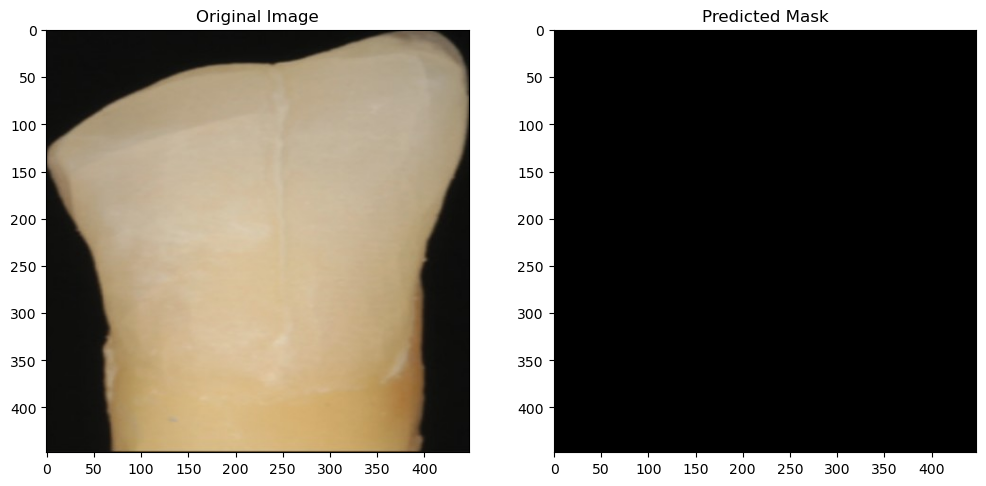

In [23]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

# Load the trained model
model = load_model('model-best.h5')

# Load and preprocess the test image
test_image_path = r'C:\Users\mehdi\Desktop\est\8.jpg'
test_image = cv2.imread(test_image_path)
test_image = cv2.resize(test_image, (448, 448))  # Resize if necessary
test_image_normalized = test_image / 255.0  # Normalize
test_image_normalized = np.expand_dims(test_image_normalized, axis=0)  # Add batch dimension

# Predict the mask
predicted_mask = model.predict(test_image_normalized)

# Apply threshold
threshold = 0.5
predicted_mask_binary = (predicted_mask > threshold).astype(np.uint8)

# Visualize the results
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(predicted_mask_binary[0, :, :, 0] * 255, cmap='gray')
plt.title('Predicted Mask')

plt.show()


In [ ]:
# Predict line mask
line_mask = model.predict(new_image)

# Apply threshold to convert probabilities to binary mask
threshold = 0.5
thresholded_mask = (line_mask > threshold).astype(np.uint8)

# Display the line mask
plt.imshow(thresholded_mask[0, :, :, 0] * 255, cmap='gray')
plt.show()


In [ ]:
from sklearn.model_selection import train_test_split


# Modify the masks to have a single channel
augmented_masks_single_channel = augmented_masks[..., 0:1]
# Split the augmented data into training and validation sets
train_images, val_images, train_masks, val_masks = train_test_split(augmented_images, augmented_masks_single_channel, test_size=0.2, random_state=42)

In [25]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate

def unet_model(input_shape):
    inputs = Input(input_shape)

    # Encoding path
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    # Add more convolutional and pooling layers as needed

    # Decoding path
    up6 = UpSampling2D(size=(2, 2))(pool1)
    merge6 = Concatenate(axis=3)([conv1, up6])
    conv6 = Conv2D(2, 3, activation='relu', padding='same')(merge6)
    # Add more upsampling and concatenation layers as needed

    # Output
    outputs = Conv2D(1, 1, activation='sigmoid')(conv6)

    model = Model(inputs=inputs, outputs=outputs)
    return model


# Build the U-Net model
input_shape = images[0].shape
model = build_unet1(input_shape)

NameError: name 'build_unet1' is not defined

In [ ]:
# Build the U-Net model
input_shape = images[0].shape
model = unet_model(input_shape)

In [49]:
# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy')
# Train the model
model.fit(train_images, train_masks, batch_size=8, epochs=20, validation_data=(val_images, val_masks))

Epoch 1/20
5/5 [==============================] - 10s 2s/step - loss: 0.6654 - val_loss: 0.5485
Epoch 2/20
5/5 [==============================] - 8s 2s/step - loss: 0.4744 - val_loss: 0.2996
Epoch 3/20
5/5 [==============================] - 8s 2s/step - loss: 0.2797 - val_loss: 0.1629
Epoch 4/20
5/5 [==============================] - 8s 2s/step - loss: 0.1834 - val_loss: 0.1162
Epoch 5/20
5/5 [==============================] - 8s 2s/step - loss: 0.1423 - val_loss: 0.0951
Epoch 6/20
5/5 [==============================] - 8s 2s/step - loss: 0.1169 - val_loss: 0.0807
Epoch 7/20
5/5 [==============================] - 8s 2s/step - loss: 0.0977 - val_loss: 0.0695
Epoch 8/20
5/5 [==============================] - 8s 2s/step - loss: 0.0827 - val_loss: 0.0604
Epoch 9/20
5/5 [==============================] - 9s 2s/step - loss: 0.0705 - val_loss: 0.0529
Epoch 10/20
5/5 [==============================] - 8s 2s/step - loss: 0.0605 - val_loss: 0.0467
Epoch 11/20
5/5 [==============================]

In [50]:
# Evaluate the model
eval_loss = model.evaluate(val_images, val_masks)
print("Evaluation Loss:", eval_loss)

1/1 [==============================] - 4s 4s/step - loss: 0.0232
Evaluation Loss: 0.02320326864719391


In [26]:
# Perform inference on new images
new_image_path = '3.jpg'
new_image = cv2.imread(new_image_path)

# Preprocess the new image
new_image = np.expand_dims(new_image, axis=0)

# Predict line mask
line_mask = model.predict(new_image)

# Threshold the line mask
threshold = 0.5
thresholded_mask = (line_mask > threshold).astype(np.uint8)

# Perform post-processing if needed (e.g., morphological operations or line fitting)

# Visualize the line mask
cv2.imshow("Line Mask", thresholded_mask[0] * 255)
cv2.waitKey(0)
cv2.destroyAllWindows()

1/1 [==============================] - 0s 474ms/step


1/1 [==============================] - 0s 382ms/step


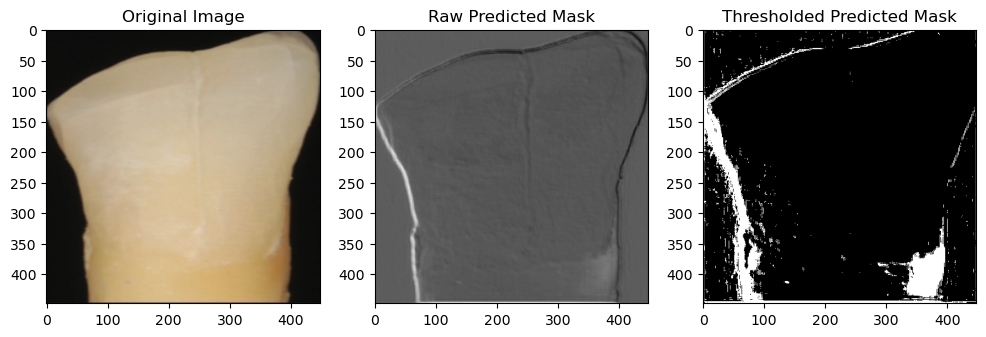

In [27]:
# Predict the mask
predicted_mask = model.predict(test_image_normalized)

# Visualize the raw predictions
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplot(1, 3, 2)
plt.imshow(predicted_mask[0, :, :, 0], cmap='gray')
plt.title('Raw Predicted Mask')

# Apply threshold and visualize
threshold = 0.5
predicted_mask_binary = (predicted_mask > threshold).astype(np.uint8)

plt.subplot(1, 3, 3)
plt.imshow(predicted_mask_binary[0, :, :, 0] * 255, cmap='gray')
plt.title('Thresholded Predicted Mask')

plt.show()


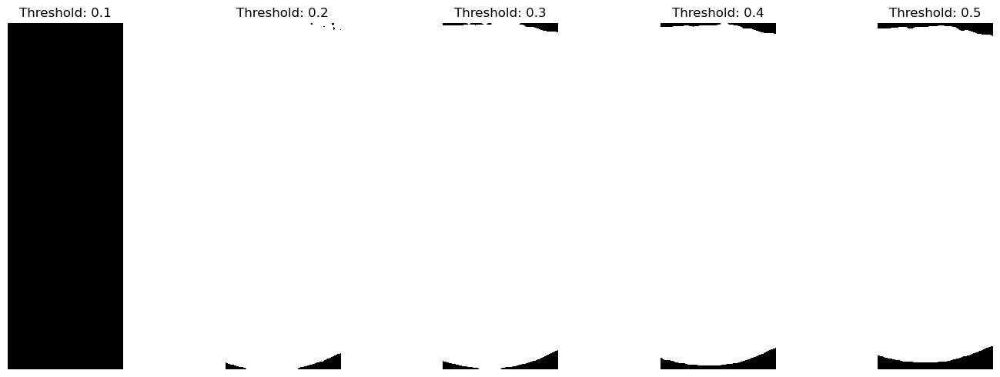

In [31]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

# Load the predicted mask from the uploaded file
predicted_mask_path = r'C:\Users\mehdi\Desktop\est\3.jpg'


# Read the image using OpenCV
predicted_mask = cv2.imread(predicted_mask_path, cv2.IMREAD_UNCHANGED)

# Since the image contains three panels, we assume each panel has equal width and extract the middle panel (raw predicted mask)
panel_width = predicted_mask.shape[1] // 3
raw_predicted_mask = predicted_mask[:, panel_width:2 * panel_width]

# Convert the raw predicted mask to grayscale if it's not already
if len(raw_predicted_mask.shape) == 3:
    raw_predicted_mask = cv2.cvtColor(raw_predicted_mask, cv2.COLOR_BGR2GRAY)

# Normalize the raw predicted mask to be in the range [0, 1]
raw_predicted_mask_normalized = raw_predicted_mask.astype(np.float32) / 255.0

# Now let's try different threshold values to see if we can get a better visualization
thresholds = [0.1, 0.2, 0.3, 0.4, 0.5]

# Create a figure to visualize the masks with different thresholds
plt.figure(figsize=(15, 5))
for i, thresh in enumerate(thresholds):
    # Apply threshold
    thresholded_mask = (raw_predicted_mask_normalized > thresh).astype(np.uint8)

    # Plotting
    plt.subplot(1, len(thresholds), i + 1)
    plt.imshow(thresholded_mask, cmap='gray')
    plt.title(f'Threshold: {thresh}')
    plt.axis('off')

plt.tight_layout()
plt.show()



In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to calculate the angle between two lines
def calculate_angle(line1, line2):
    # Calculate the direction vectors of the two lines
    vector_a = np.array([line1[2] - line1[0], line1[3] - line1[1]])
    vector_b = np.array([line2[2] - line2[0], line2[3] - line2[1]])
    unit_vector_a = vector_a / np.linalg.norm(vector_a)
    unit_vector_b = vector_b / np.linalg.norm(vector_b)
    dot_product = np.dot(unit_vector_a, unit_vector_b)
    angle_rad = np.arccos(dot_product)
    angle_deg = np.degrees(angle_rad)
    return angle_deg

# Load the image from the provided path
image_path = r'C:\Users\mehdi\Desktop\est\10.jpg'  # Replace with your actual image path
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Perform edge detection using Canny
edges = cv2.Canny(image, 50, 150, apertureSize=3)

# Detect lines using the Hough Line Transform
lines = cv2.HoughLinesP(edges, 1, np.pi / 180, threshold=50, minLineLength=50, maxLineGap=10)

# Initialize an empty list to store angles
angles


[69.07549825507884,
 4.653351587268408,
 70.51387042753424,
 37.51911382047633,
 73.72884984234722,
 139.58936868261307,
 31.556384434602503,
 65.86051884026585,
 42.17246540774472,
 108.03298424801058]

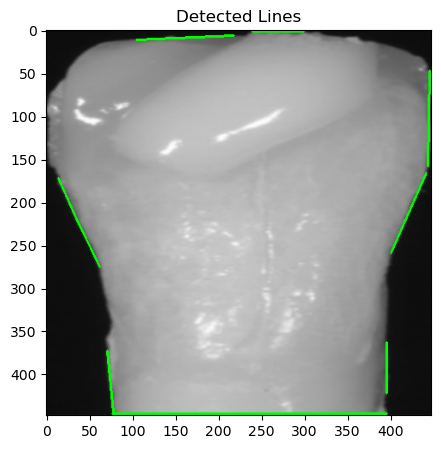

Angles between lines:
2.5335588883945728
88.96775530843426
90.0
64.29004621918874
66.2092261342228
0.0
84.44702896696319
66.03751102542181
86.4341964200397
87.46644111160542
66.82360510758332
63.67566724582823
2.5335588883945728
86.98058785535778
68.5710699138164
1.032244691565731
153.257801527623
22.758529174211475
88.96775530843426
173.4147842753975
155.0052663338561
154.29004621918875
23.7907738657772
90.0
174.44702896696325
156.03751102542182
130.49927235341153
64.29004621918874
20.15698274777447
1.7474648062331335
66.2092261342228
150.65625510118602
132.24673715964462
84.44702896696319
66.03751102542181
18.409517941541356


In [14]:
angles = []

# Check if any lines are detected
if lines is not None:
    # Iterate over every pair of lines
    for i in range(len(lines)):
        for j in range(i+1, len(lines)):
            # Get the first line coordinates
            x1_1, y1_1, x2_1, y2_1 = lines[i][0]
            # Get the second line coordinates
            x1_2, y1_2, x2_2, y2_2 = lines[j][0]
            # Calculate the angle between the two lines
            angle = calculate_angle((x1_1, y1_1, x2_1, y2_1), (x1_2, y1_2, x2_2, y2_2))
            angles.append(angle)

    # Create a copy of the image to draw lines
    line_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    # Draw the lines on the image
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(line_image, (x1, y1), (x2, y2), (0, 255, 0), 2)

    # Show the result
    plt.figure(figsize=(5, 5))
    plt.imshow(line_image)
    plt.title('Detected Lines')
    plt.show()

    # Print the angles
    print("Angles between lines:")
    for angle in angles:
        print(angle)
else:
    print("No lines detected")
